# Understanding Denoising Diffusion Probabilistic Models (DDPM)

This Jupyter Notebook is derived from a notebook by deepfindr@gmail.com, their notebook can be found in the description of their YouTube video (https://youtu.be/a4Yfz2FxXiY?si=sRHWekx6D0esnGZJ) about DDPM and it helped me to better understand the logic behing the model and how it is capable of generating images. I recommend watching it.

In [ ]:
import torch
import torchvision
import matplotlib.pyplot as plt
import torch.nn.functional as F
from torchvision import transforms
from torch.utils.data import DataLoader, Subset
import numpy as np
from torch import nn
import math

On the original notebook, they used the StanfordCars dataset, which is not available anymore in the recent version of torchvision. For this reason, I used STL10 dataset and used only the cars imagem for training the model.

The function show_images display some sample from the dataset after applying a mask to retrieve only the cars.

Files already downloaded and verified
['airplane', 'bird', 'car', 'cat', 'deer', 'dog', 'horse', 'monkey', 'ship', 'truck']
total cars: 500


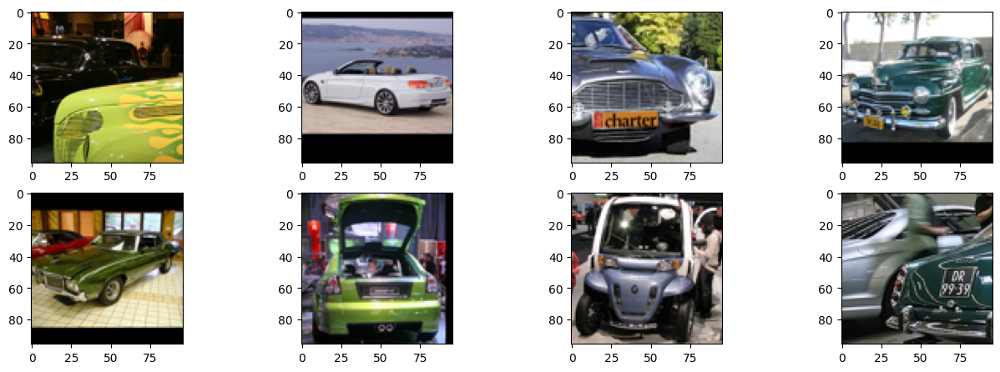

In [ ]:
def show_images(dataset, num_samples=8, cols=4):
    """ Plots some samples from the dataset """
    plt.figure(figsize=(16,8))
    for i in range(num_samples):
        plt.subplot(int(num_samples/cols) + 1, cols, i + 1)
        img = dataset[i].transpose(1,2,0) # change axis order from c,row,col to row,col,c
        plt.imshow(img)

data = torchvision.datasets.STL10(root=".", download=True)
print(data.classes) # class car is label 2
mask = data.labels == 2
print("total cars:", sum(mask))
cars = data.data[mask]
show_images(cars)



The function linear_beta_schedule create a list of betas which is the increasing variance over t.

In [ ]:
def linear_beta_schedule(timesteps, start=0.0001, end=0.02):
    return torch.linspace(start, end, timesteps)

def get_index_from_list(vals, t, x_shape):
    """
    Returns a specific index t of a passed list of values vals
    while considering the batch dimension.
    """
    batch_size = t.shape[0]
    out = vals.gather(-1, t.cpu()) # gets vals[t]
    return out.reshape(batch_size, *((1,) * (len(x_shape) - 1))).to(t.device) # reshape output to (1,1,1)

def forward_diffusion_sample(x_0, t, device="cpu"):
    """
    Takes an image and a timestep as input and
    returns the noisy version of it
    """
    noise = torch.randn_like(x_0)
    sqrt_alphas_cumprod_t = get_index_from_list(sqrt_alphas_cumprod, t, x_0.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x_0.shape
    )
    # mean + variance
    return sqrt_alphas_cumprod_t.to(device) * x_0.to(device) \
    + sqrt_one_minus_alphas_cumprod_t.to(device) * noise.to(device), noise.to(device) # return the noise image and the noise

In [ ]:
# Define beta schedule
# beta is the variance schedule. The variance increases over the time t
T = 300
betas = linear_beta_schedule(timesteps=T) # similar to np.linspace

In [ ]:
# Pre-calculate different terms for closed form
# sqrt alpha is the mean that depends on beta. The mean decreases as beta increases over t
alphas = 1. - betas
alphas_cumprod = torch.cumprod(alphas, axis=0)
alphas_cumprod_prev = F.pad(alphas_cumprod[:-1], (1, 0), value=1.0) # adds 1 in front and exclude last
sqrt_recip_alphas = torch.sqrt(1.0 / alphas)
sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
sqrt_one_minus_alphas_cumprod = torch.sqrt(1. - alphas_cumprod)
posterior_variance = betas * (1. - alphas_cumprod_prev) / (1. - alphas_cumprod)

In [ ]:
IMG_SIZE = 64
BATCH_SIZE = 128

In [ ]:
def load_transformed_dataset():
    '''
    Get train and test dataset from STL10 and apply the transformation
    Return the concatenation of train and test
    '''
    data_transforms = [
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(), # Scales data into [0,1]
        transforms.Lambda(lambda t: (t * 2) - 1) # Scale between [-1, 1]
    ]
    data_transform = transforms.Compose(data_transforms)

    train = torchvision.datasets.STL10(root=".", download=True,
                                         transform=data_transform)
    test = torchvision.datasets.STL10(root=".", download=True,
                                         transform=data_transform, split='test')
    return torch.utils.data.ConcatDataset([train, test])

def show_tensor_image(image):
    reverse_transforms = transforms.Compose([
        transforms.Lambda(lambda t: (t + 1) / 2),
        transforms.Lambda(lambda t: t.permute(1, 2, 0)), # CHW to HWC
        transforms.Lambda(lambda t: t * 255.),
        transforms.Lambda(lambda t: t.numpy().astype(np.uint8)),
        transforms.ToPILImage(),
    ])

    # Take first image of batch
    if len(image.shape) == 4:
        image = image[0, :, :, :]
    plt.imshow(reverse_transforms(image))

In [ ]:
data = load_transformed_dataset()
mask = [i for i in range(len(data)) if data[i][1] == 2]
print("cars total:", len(mask))
data = Subset(data, mask)
dataloader = DataLoader(data, batch_size=BATCH_SIZE, shuffle=True, drop_last=True)

Files already downloaded and verified
Files already downloaded and verified
cars total: 1300


<ipython-input-9-f92d18059fc8>:11: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images+1, int(idx/stepsize) + 1)


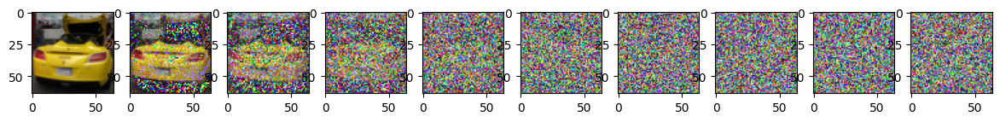

In [ ]:
# Simulate forward diffusion
image = next(iter(dataloader))[0]

plt.figure(figsize=(16,2))
plt.axis('off')
num_images = 10
stepsize = int(T/num_images)

for idx in range(0, T, stepsize):
    t = torch.Tensor([idx]).type(torch.int64)
    plt.subplot(1, num_images+1, int(idx/stepsize) + 1)
    img, noise = forward_diffusion_sample(image, t)
    show_tensor_image(img)

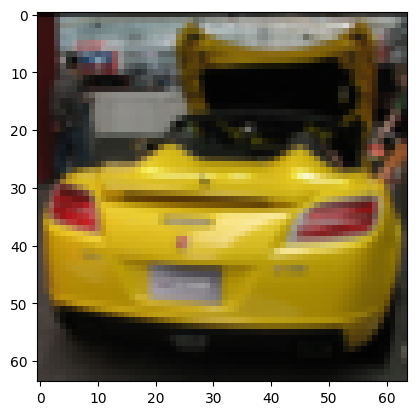

In [ ]:
noise = torch.randn_like(image)
show_tensor_image(image)

In [ ]:
class Block(nn.Module):
    def __init__(self, in_ch, out_ch, time_emb_dim, up=False):
        super().__init__()
        self.time_mlp =  nn.Linear(time_emb_dim, out_ch)
        if up:
            self.conv1 = nn.Conv2d(2*in_ch, out_ch, 3, padding=1)
            self.transform = nn.ConvTranspose2d(out_ch, out_ch, 4, 2, 1)
        else:
            self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
            self.transform = nn.Conv2d(out_ch, out_ch, 4, 2, 1)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.bnorm1 = nn.BatchNorm2d(out_ch)
        self.bnorm2 = nn.BatchNorm2d(out_ch)
        self.relu  = nn.ReLU()

    def forward(self, x, t, ):
        # First Conv
        h = self.bnorm1(self.relu(self.conv1(x)))
        # Time embedding
        time_emb = self.relu(self.time_mlp(t))
        # Extend last 2 dimensions
        time_emb = time_emb[(..., ) + (None, ) * 2]
        # Add time channel
        h = h + time_emb
        # Second Conv
        h = self.bnorm2(self.relu(self.conv2(h)))
        # Down or Upsample
        return self.transform(h)


class SinusoidalPositionEmbeddings(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time):
        device = time.device # time is the input
        half_dim = 32 // 2
        k = torch.arange(half_dim, device=device)
        k.repeat_interleave(2)
        w = 1/torch.pow(10000, 2*k/32)
        embeddings = w.repeat_interleave(2)
        embeddings = time[:, None] * embeddings[None, :]
        embeddings = torch.where(torch.arange(2*half_dim, device=device) % 2 == 0, embeddings.sin(), embeddings.cos())
        return embeddings


class SimpleUnet(nn.Module):
    """
    A simplified variant of the Unet architecture.
    Input is a noisy image, the ouput the noise in the image
    Timestep is encoded by the transformer Sinusoidal Embedding
    """
    def __init__(self):
        super().__init__()
        image_channels = 3
        down_channels = (64, 128, 256, 512, 1024)
        up_channels = (1024, 512, 256, 128, 64)
        out_dim = 3
        time_emb_dim = 32

        # Time embedding
        self.time_mlp = nn.Sequential(
                SinusoidalPositionEmbeddings(time_emb_dim), # input size 32
                nn.Linear(time_emb_dim, time_emb_dim), # input size 32, output size 32
                nn.ReLU()
            )

        # Initial projection
        self.conv0 = nn.Conv2d(image_channels, down_channels[0], 3, padding=1)

        # Downsample
        self.downs = nn.ModuleList([Block(down_channels[i], down_channels[i+1], \
                                    time_emb_dim) \
                    for i in range(len(down_channels)-1)])
        # Upsample
        self.ups = nn.ModuleList([Block(up_channels[i], up_channels[i+1], \
                                        time_emb_dim, up=True) \
                    for i in range(len(up_channels)-1)])

        # Edit: Corrected a bug found by Jakub C (see YouTube comment)
        self.output = nn.Conv2d(up_channels[-1], out_dim, 1)

    def forward(self, x, timestep):
        # Embedd time
        t = self.time_mlp(timestep)
        # Initial conv
        x = self.conv0(x)
        # Unet
        residual_inputs = []
        for down in self.downs:
            x = down(x, t)
            residual_inputs.append(x)
        for up in self.ups:
            residual_x = residual_inputs.pop()
            # Add residual x as additional channels
            x = torch.cat((x, residual_x), dim=1)
            x = up(x, t)
        return self.output(x)

model = SimpleUnet()
print("Num params: ", sum(p.numel() for p in model.parameters()))
model

Num params:  62438883


SimpleUnet(
  (time_mlp): Sequential(
    (0): SinusoidalPositionEmbeddings()
    (1): Linear(in_features=32, out_features=32, bias=True)
    (2): ReLU()
  )
  (conv0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (downs): ModuleList(
    (0): Block(
      (time_mlp): Linear(in_features=32, out_features=128, bias=True)
      (conv1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transform): Conv2d(128, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bnorm1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (bnorm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
    )
    (1): Block(
      (time_mlp): Linear(in_features=32, out_features=256, bias=True)
      (conv1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transfor

In [ ]:
def get_loss(model, x_0, t):
    x_noisy, noise = forward_diffusion_sample(x_0, t, device)
    noise_pred = model(x_noisy, t)
    return F.l1_loss(noise, noise_pred)

In [ ]:
@torch.no_grad()
def sample_timestep(x, t):
    """
    Calls the model to predict the noise in the image and returns
    the denoised image.
    Applies noise to this image, if we are not in the last step yet.
    """
    betas_t = get_index_from_list(betas, t, x.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x.shape
    )
    sqrt_recip_alphas_t = get_index_from_list(sqrt_recip_alphas, t, x.shape)

    # Call model (current image - noise prediction)
    model_mean = sqrt_recip_alphas_t * (
        x - betas_t * model(x, t) / sqrt_one_minus_alphas_cumprod_t
    )
    posterior_variance_t = get_index_from_list(posterior_variance, t, x.shape)

    if t == 0:
        # As pointed out by Luis Pereira (see YouTube comment)
        # The t's are offset from the t's in the paper
        return model_mean
    else:
        noise = torch.randn_like(x)
        return model_mean + torch.sqrt(posterior_variance_t) * noise

@torch.no_grad()
def sample_plot_image():
    # Sample noise
    img_size = IMG_SIZE
    img = torch.randn((1, 3, img_size, img_size), device=device)
    plt.figure(figsize=(15,15))
    plt.axis('off')
    num_images = 10
    stepsize = int(T/num_images)

    for i in range(0,T)[::-1]:
        t = torch.full((1,), i, device=device, dtype=torch.long)
        img = sample_timestep(img, t)
        # Edit: This is to maintain the natural range of the distribution
        img = torch.clamp(img, -1.0, 1.0)
        if i % stepsize == 0:
            plt.subplot(1, num_images, int(i/stepsize)+1)
            show_tensor_image(img.detach().cpu())
    plt.show()

Epoch 0 | step 000 Loss: 0.8088840842247009 


<ipython-input-13-5fbd7b74e2b8>:44: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images, int(i/stepsize)+1)


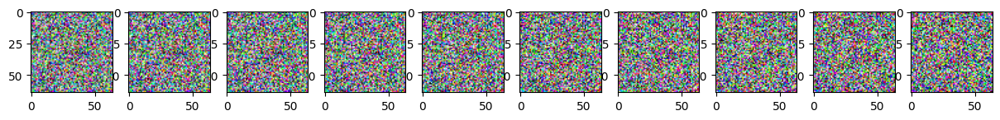

Epoch 5 | step 000 Loss: 0.35063886642456055 


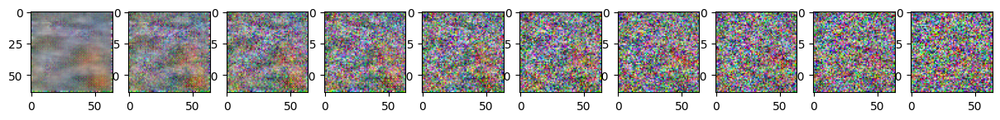

Epoch 10 | step 000 Loss: 0.25226014852523804 


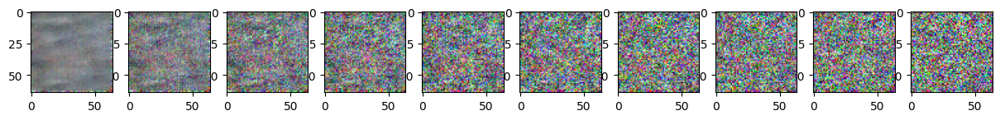

Epoch 15 | step 000 Loss: 0.22048012912273407 


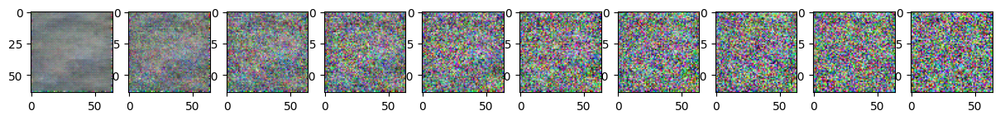

Epoch 20 | step 000 Loss: 0.21152719855308533 


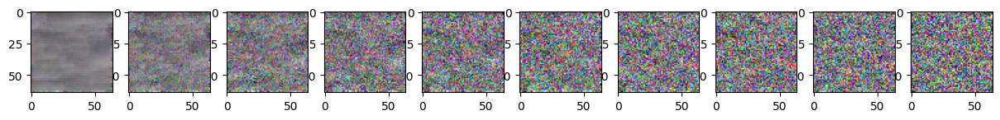

Epoch 25 | step 000 Loss: 0.20289930701255798 


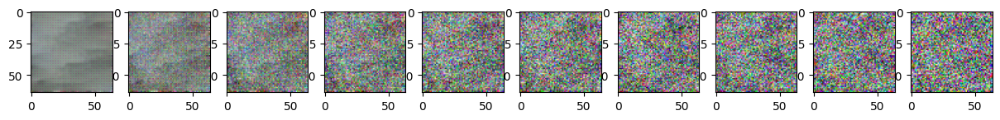

Epoch 30 | step 000 Loss: 0.19160012900829315 


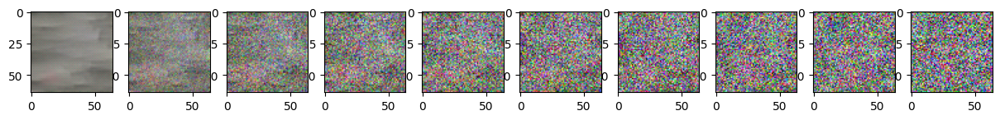

Epoch 35 | step 000 Loss: 0.17391261458396912 


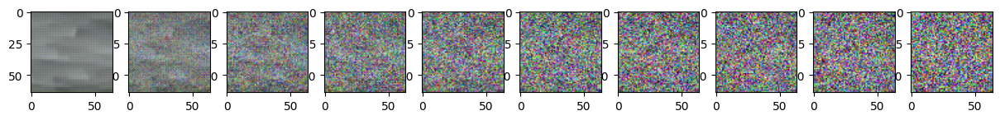

Epoch 40 | step 000 Loss: 0.1834392249584198 


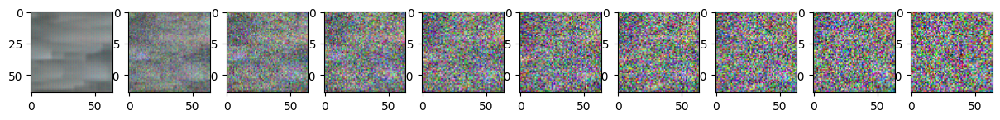

Epoch 45 | step 000 Loss: 0.17843042314052582 


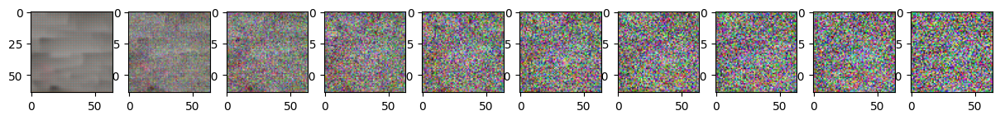

Epoch 50 | step 000 Loss: 0.16885754466056824 


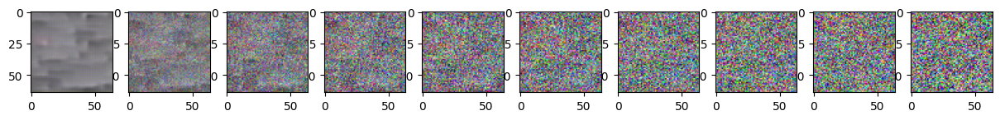

Epoch 55 | step 000 Loss: 0.1655668318271637 


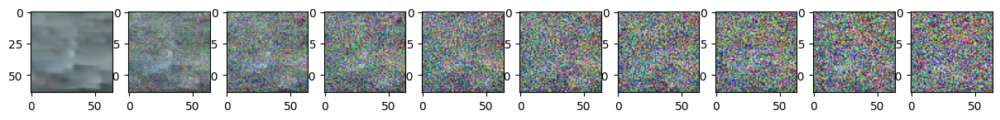

Epoch 60 | step 000 Loss: 0.17523860931396484 


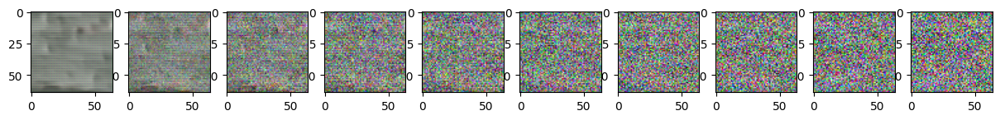

Epoch 65 | step 000 Loss: 0.162265345454216 


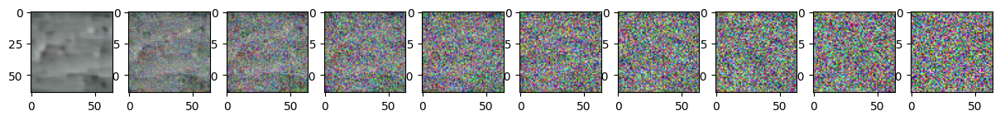

Epoch 70 | step 000 Loss: 0.14974859356880188 


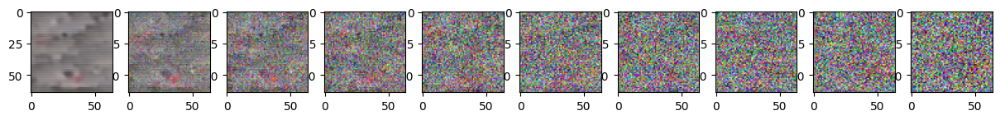

Epoch 75 | step 000 Loss: 0.1486300528049469 


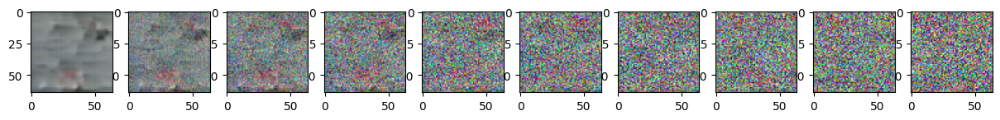

Epoch 80 | step 000 Loss: 0.17659299075603485 


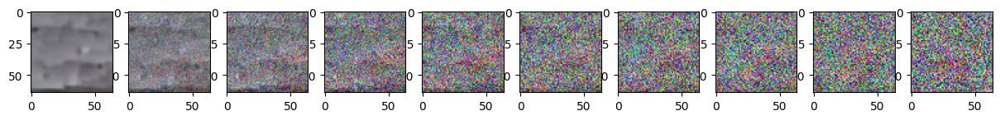

Epoch 85 | step 000 Loss: 0.15480175614356995 


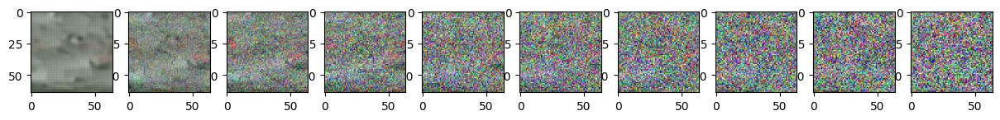

Epoch 90 | step 000 Loss: 0.1500169038772583 


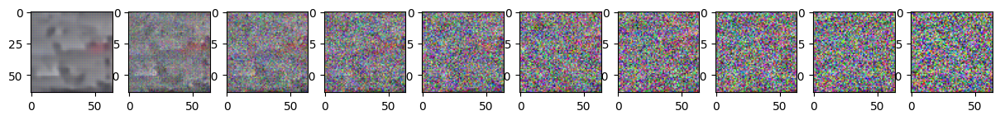

Epoch 95 | step 000 Loss: 0.15927089750766754 


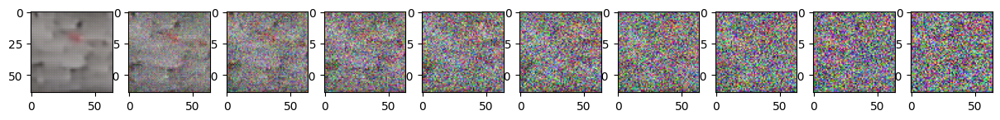

Epoch 100 | step 000 Loss: 0.15729546546936035 


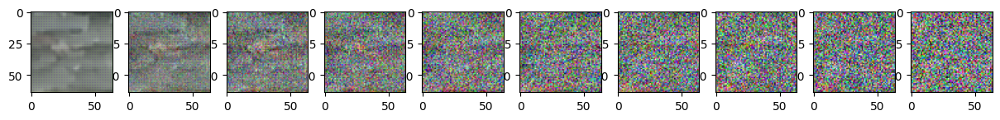

Epoch 105 | step 000 Loss: 0.15729039907455444 


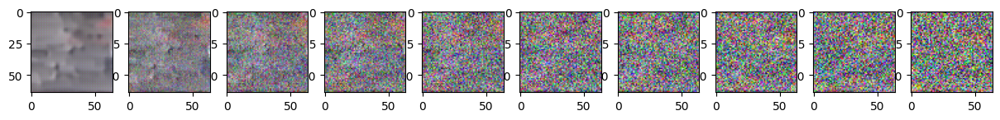

Epoch 110 | step 000 Loss: 0.15653055906295776 


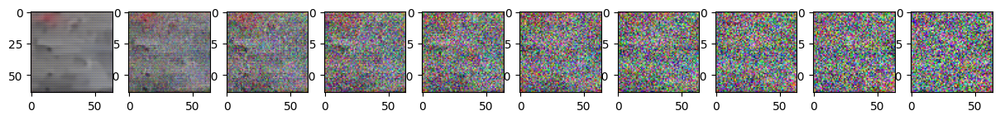

Epoch 115 | step 000 Loss: 0.15039509534835815 


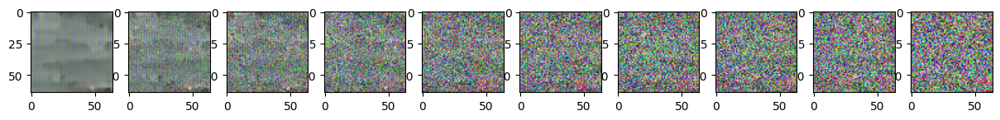

Epoch 120 | step 000 Loss: 0.16801178455352783 


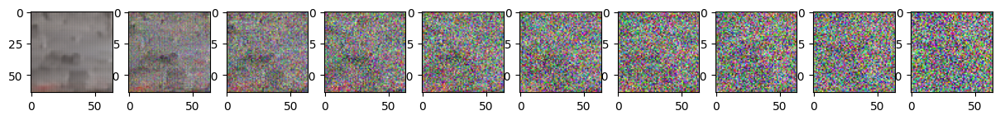

Epoch 125 | step 000 Loss: 0.14557984471321106 


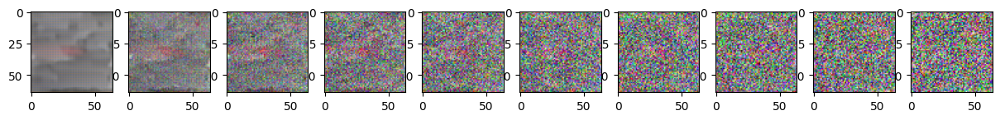

Epoch 130 | step 000 Loss: 0.15695670247077942 


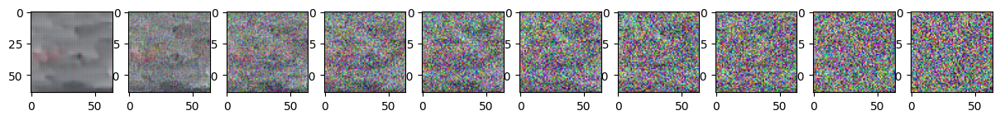

Epoch 135 | step 000 Loss: 0.1444847732782364 


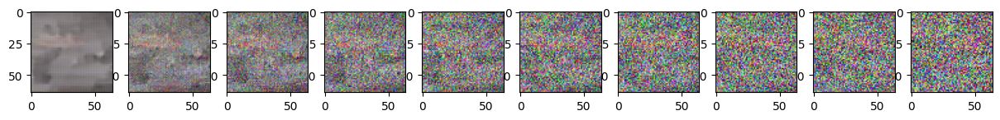

Epoch 140 | step 000 Loss: 0.14361366629600525 


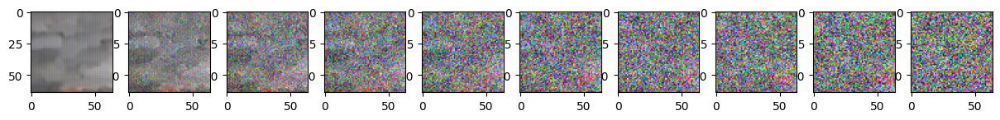

Epoch 145 | step 000 Loss: 0.13964352011680603 


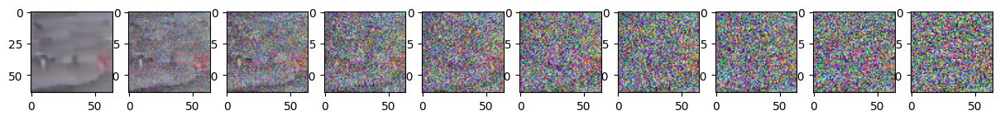

Epoch 150 | step 000 Loss: 0.14135919511318207 


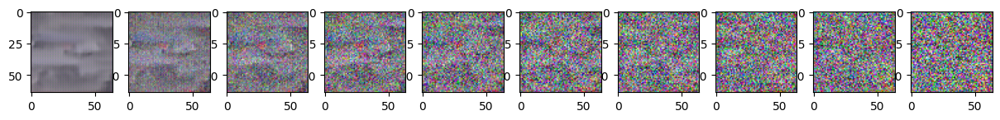

Epoch 155 | step 000 Loss: 0.14906446635723114 


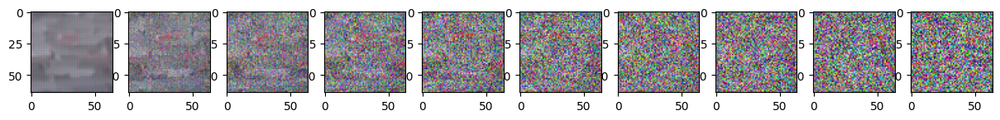

Epoch 160 | step 000 Loss: 0.15279822051525116 


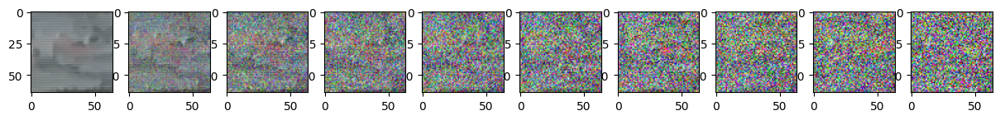

Epoch 165 | step 000 Loss: 0.1596301645040512 


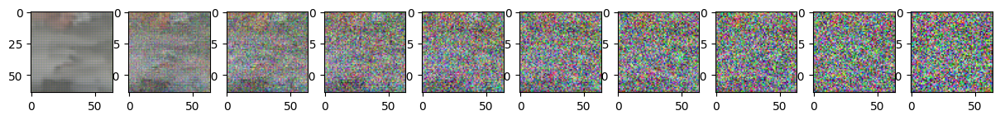

Epoch 170 | step 000 Loss: 0.15302690863609314 


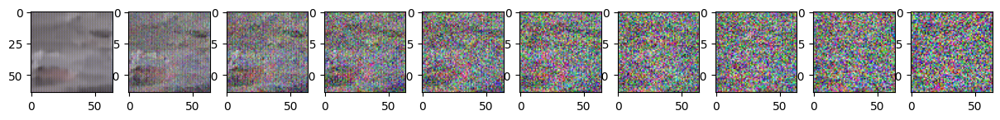

Epoch 175 | step 000 Loss: 0.13930484652519226 


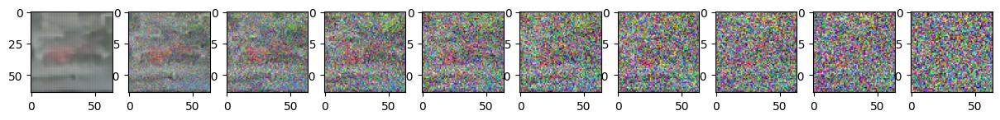

Epoch 180 | step 000 Loss: 0.15482236444950104 


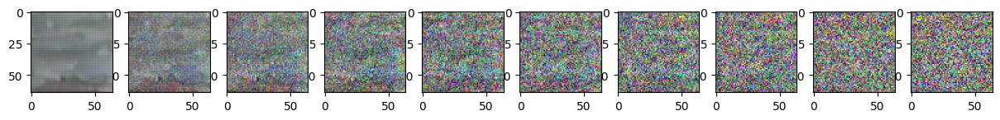

Epoch 185 | step 000 Loss: 0.1459406018257141 


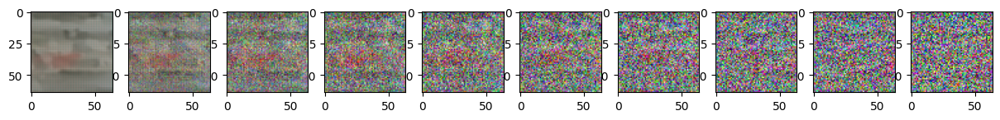

Epoch 190 | step 000 Loss: 0.13823360204696655 


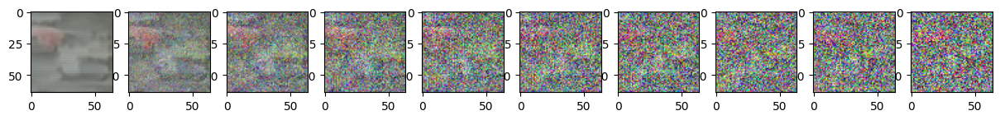

Epoch 195 | step 000 Loss: 0.14075860381126404 


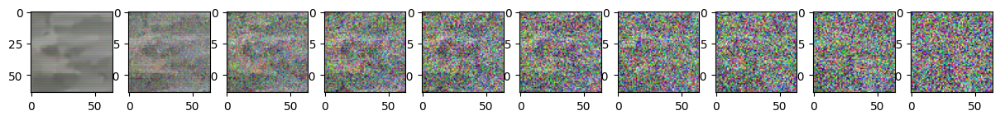

Epoch 200 | step 000 Loss: 0.13401490449905396 


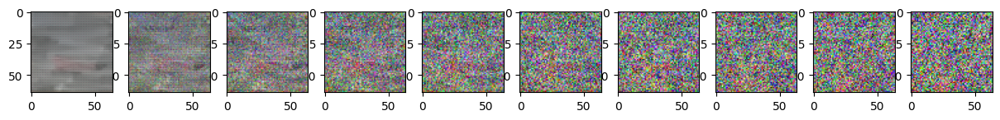

Epoch 205 | step 000 Loss: 0.14376196265220642 


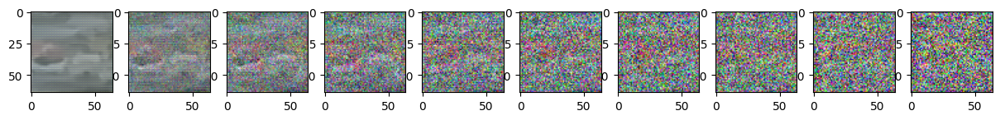

Epoch 210 | step 000 Loss: 0.1515347957611084 


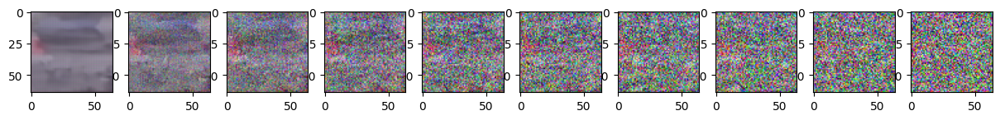

Epoch 215 | step 000 Loss: 0.13885997235774994 


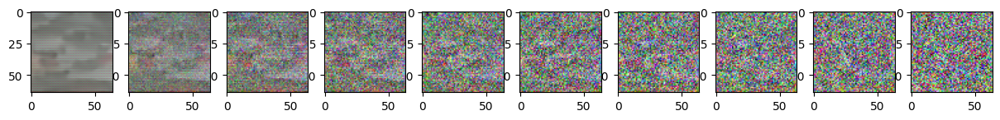

Epoch 220 | step 000 Loss: 0.14262144267559052 


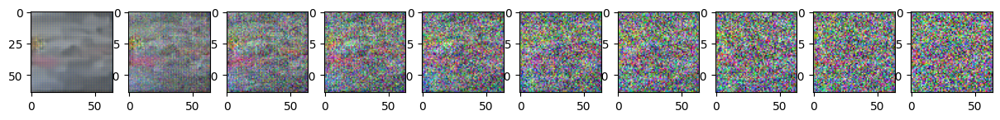

Epoch 225 | step 000 Loss: 0.14576034247875214 


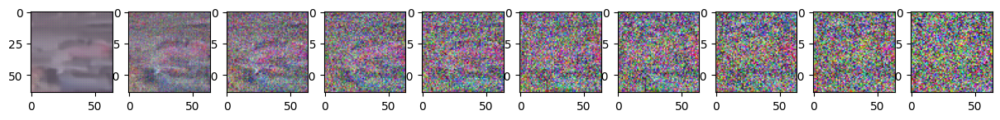

Epoch 230 | step 000 Loss: 0.16550835967063904 


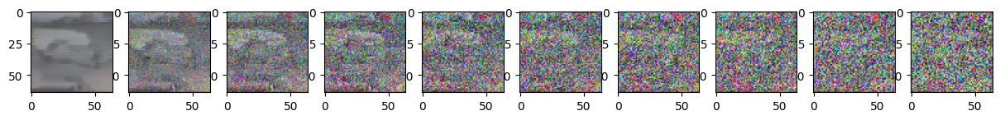

Epoch 235 | step 000 Loss: 0.15367569029331207 


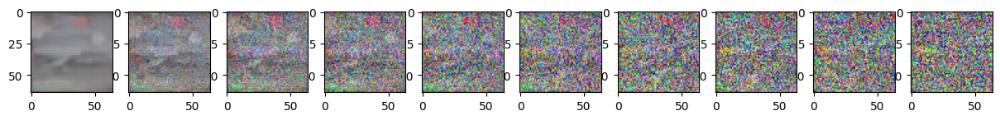

Epoch 240 | step 000 Loss: 0.144243523478508 


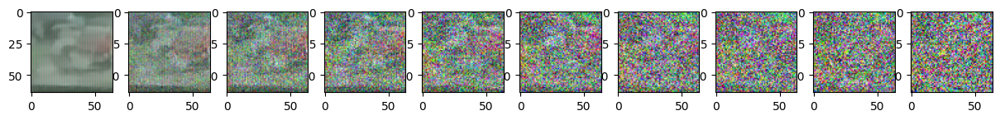

Epoch 245 | step 000 Loss: 0.14376519620418549 


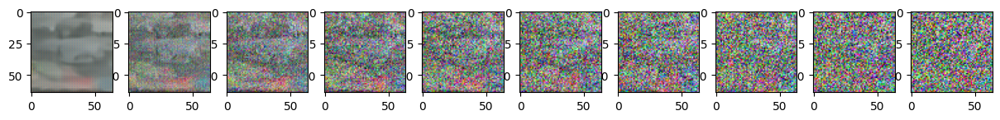

Epoch 250 | step 000 Loss: 0.13720504939556122 


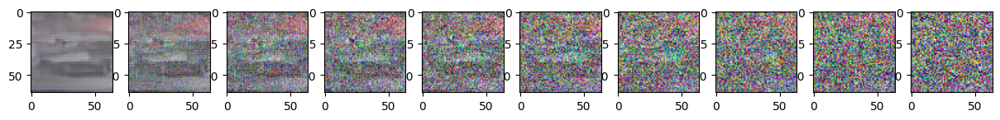

Epoch 255 | step 000 Loss: 0.13010834157466888 


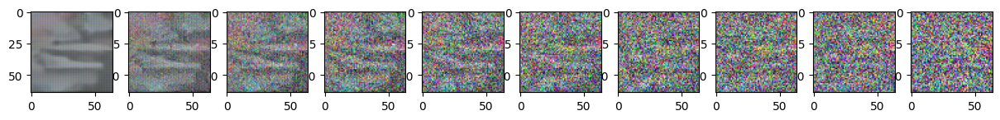

Epoch 260 | step 000 Loss: 0.13062213361263275 


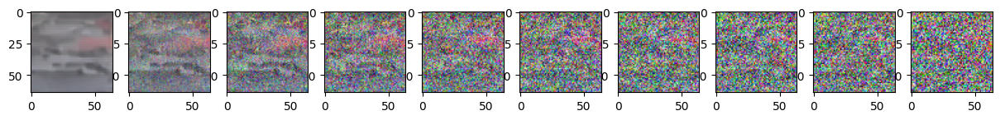

Epoch 265 | step 000 Loss: 0.13446572422981262 


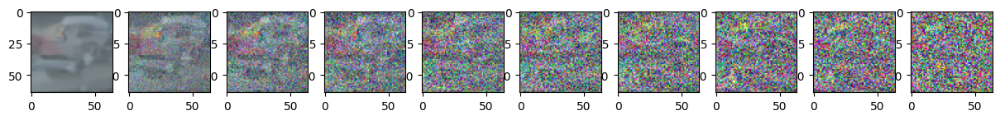

Epoch 270 | step 000 Loss: 0.1412857174873352 


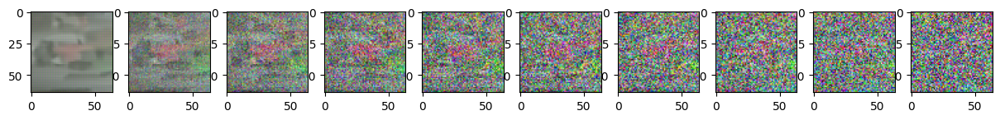

Epoch 275 | step 000 Loss: 0.1451631337404251 


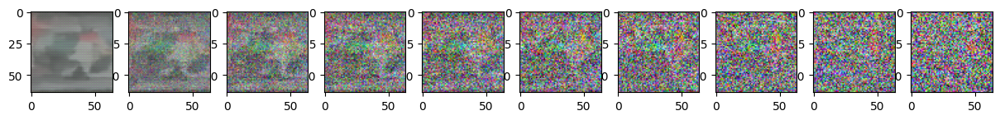

Epoch 280 | step 000 Loss: 0.14995573461055756 


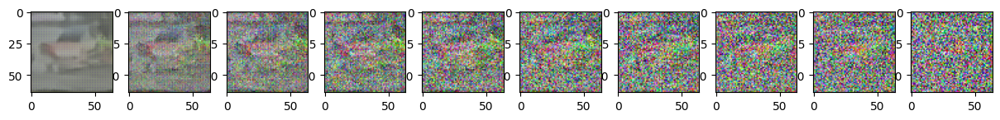

Epoch 285 | step 000 Loss: 0.15626052021980286 


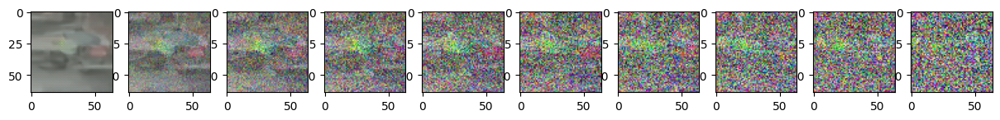

Epoch 290 | step 000 Loss: 0.13742737472057343 


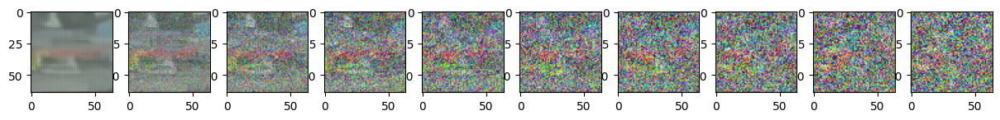

Epoch 295 | step 000 Loss: 0.15499210357666016 


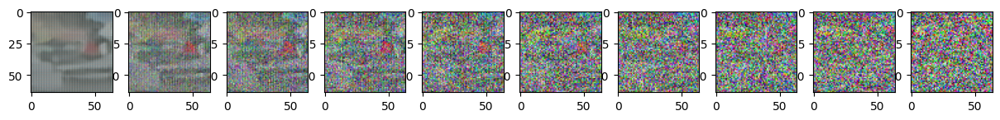

In [ ]:
from torch.optim import Adam

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)
optimizer = Adam(model.parameters(), lr=0.001)
epochs = 600 # Try more!

for epoch in range(epochs):
    for step, batch in enumerate(dataloader):

        optimizer.zero_grad()

        t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
        loss = get_loss(model, batch[0], t)
        loss.backward()
        optimizer.step()

        if epoch % 5 == 0 and step == 0:
            print(f"Epoch {epoch} | step {step:03d} Loss: {loss.item()} ")
            sample_plot_image()